In [2]:
import os
import pandas as pd
import numpy as np
import glob
import csv
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

plt.style.use('bmh')

In [3]:
from scipy.stats import skew, kurtosis
from statsmodels.tsa import stattools
import numpy as np
import math

def jitter(v):
    """
    Calculate jitter in a vectorized form. Time axis is assumed to be 0.
    We assume, that `v` is 2D array.
    """
    return np.sum(np.abs(v.values[1:] - v.values[:-1]), axis=0)/v.shape[0]


def mean_crossing_rate(v):
        """
        Calculate MCR in a vectorized form. Time axis is assumed to be 0.
        We assume, that `v` is 2D array.
        """

        m = v.mean(axis=0)
        crossings = np.logical_or(np.logical_and((v.values > m)[1:], (v.values < m)[:-1]), # crossing downwards
                                  np.logical_and((v.values < m)[1:], (v.values > m)[:-1])) # crossing upwards
        return np.mean(crossings, axis=0)
    


In [4]:
''' v is a sample : assumed tobe a 2d array'''
# mean auto correlation
def acf_mean(v):
    return stattools.acf(v).mean()
# standard deviation auto correlation
def acf_std(v):
    return stattools.acf(v).std()
# mean auto covariance   
def acv_mean(v):
    return stattools.acovf(v).mean()
# standard deviation auto covariance
def acv_std(v):
    return stattools.acovf(v).std()
    
    
    

### read files into a dataframe

In [5]:
#reading the files:
DATA_DIR = "./nexar/"
!ls nexar

f1  f2	high_rated-2018-11-24  zero_rated-2018-11-24


In [6]:
samples_accel = glob.glob("nexar/*/*/*_Accel.csv")
samples_gyro=glob.glob("nexar/*/*/*_Gyro.csv")
print("there are {}  accel samples".format(len(samples_accel)))
print("there are {}  gyro samples".format(len(samples_gyro)))
samples_gyro[:10], samples_accel[:10]


there are 4133  accel samples
there are 4010  gyro samples


(['nexar/zero_rated-2018-11-24/01664c5ac370136abc20d7ac52d0ec48/01664c5ac370136abc20d7ac52d0ec48_Gyro.csv',
  'nexar/zero_rated-2018-11-24/0899c7acdc74c1d2fc16b3ba7dff47c6/0899c7acdc74c1d2fc16b3ba7dff47c6_Gyro.csv',
  'nexar/zero_rated-2018-11-24/049b7df2a36aad19543151765819a213/049b7df2a36aad19543151765819a213_Gyro.csv',
  'nexar/zero_rated-2018-11-24/0515cba67277eed2d285e802421ba4da/0515cba67277eed2d285e802421ba4da_Gyro.csv',
  'nexar/zero_rated-2018-11-24/02680761599287696ed79852c0dd620a/02680761599287696ed79852c0dd620a_Gyro.csv',
  'nexar/zero_rated-2018-11-24/02568073d035831b1a48da560c66517f/02568073d035831b1a48da560c66517f_Gyro.csv',
  'nexar/zero_rated-2018-11-24/0c21adff6082397f894a4ada32f91799/0c21adff6082397f894a4ada32f91799_Gyro.csv',
  'nexar/zero_rated-2018-11-24/058189e924c41c47950b30187942036a/058189e924c41c47950b30187942036a_Gyro.csv',
  'nexar/zero_rated-2018-11-24/0a6d74cf9408ebac05765cc7fe5bb4d5/0a6d74cf9408ebac05765cc7fe5bb4d5_Gyro.csv',
  'nexar/zero_rated-2018-11-

In [7]:
def get_ids(fname):
    """Calculate `sample_id` and short filename."""
    start_dir, filename = os.path.split(fname)
    base_dir, sample_id = os.path.split(start_dir)
    _, sample_class = os.path.split(base_dir)
    sample_class= sample_class
    return (sample_id, sample_class, filename)


## Read file of gyro and of acceleration to see they are syncronic in time

In [8]:
#Let's read 1 file of gyro and 1 files of accelerometer:
gyro_df= pd.read_csv("nexar/zero_rated-2018-11-24/01664c5ac370136abc20d7ac52d0ec48/01664c5ac370136abc20d7ac52d0ec48_Gyro.csv")
accel_df= pd.read_csv("nexar/zero_rated-2018-11-24/049b7df2a36aad19543151765819a213/049b7df2a36aad19543151765819a213_Accel.csv")
accel_df["timestamp"] = pd.to_datetime(accel_df['timestamp'], unit="s")
gyro_df["timestamp"] = pd.to_datetime(gyro_df['timestamp'], unit="s")
gyro_df=gyro_df.resample('1S', on="timestamp").mean()
accel_df=accel_df.set_index('timestamp')
accel_df.head()

,signal_x,signal_y,signal_z
timestamp,,,
2018-08-19 21:19:03.012259960,0.311,-0.994,0.093
2018-08-19 21:19:03.031577826,0.332,-1.047,0.130
2018-08-19 21:19:03.050896168,0.348,-1.063,0.159
2018-08-19 21:19:03.070213079,0.312,-1.016,0.154
2018-08-19 21:19:03.089530945,0.235,-0.974,0.106


In [9]:
print(accel_df.shape, gyro_df.shape)
gyro_df.head()


(2071, 3) (40, 3)


,signal_x,signal_y,signal_z
timestamp,,,
2018-10-19 12:40:58,-0.029127,0.008973,-0.061517
2018-10-19 12:40:59,-0.024144,0.002469,-0.016690
2018-10-19 12:41:00,-0.031487,0.008731,0.010558
2018-10-19 12:41:01,-0.047450,-0.009837,0.001671
2018-10-19 12:41:02,-0.028131,0.012825,0.049756


In [10]:
files_accel=pd.DataFrame([get_ids(sample) for sample in samples_accel],
                     columns=["sample_id", "class", "accel_file"])
files_gyro=pd.DataFrame([get_ids(sample) for sample in samples_gyro],
                     columns=["sample_id", "class", "gyro_file"])

In [11]:
print("Accel: number of dangerous rides {}".format(files_accel[files_accel['class']=="high_rated-2018-11-24"].shape[0]))
print("Accel: number of not dangerous rides {}".format(files_accel[files_accel['class']=="zero_rated-2018-11-24"].shape[0]))
print("Accel:number of files: {}".format(files_accel.shape[0]))
print("Gyro: number of dangerous rides {}".format(files_gyro[files_gyro['class']=="high_rated-2018-11-24"].shape[0]))
print("Gyro: number of not dangerous rides {}".format(files_gyro[files_gyro['class']=="zero_rated-2018-11-24"].shape[0]))
print("Gyro:number of files: {}".format(files_gyro.shape[0]))

Accel: number of dangerous rides 2222
Accel: number of not dangerous rides 1911
Accel:number of files: 4133
Gyro: number of dangerous rides 2214
Gyro: number of not dangerous rides 1796
Gyro:number of files: 4010


In [12]:
files_gyro.head() ,files_accel.head()


(                          sample_id                  class  \
 0  01664c5ac370136abc20d7ac52d0ec48  zero_rated-2018-11-24   
 1  0899c7acdc74c1d2fc16b3ba7dff47c6  zero_rated-2018-11-24   
 2  049b7df2a36aad19543151765819a213  zero_rated-2018-11-24   
 3  0515cba67277eed2d285e802421ba4da  zero_rated-2018-11-24   
 4  02680761599287696ed79852c0dd620a  zero_rated-2018-11-24   
 
                                    gyro_file  
 0  01664c5ac370136abc20d7ac52d0ec48_Gyro.csv  
 1  0899c7acdc74c1d2fc16b3ba7dff47c6_Gyro.csv  
 2  049b7df2a36aad19543151765819a213_Gyro.csv  
 3  0515cba67277eed2d285e802421ba4da_Gyro.csv  
 4  02680761599287696ed79852c0dd620a_Gyro.csv  ,
                           sample_id                  class  \
 0  01664c5ac370136abc20d7ac52d0ec48  zero_rated-2018-11-24   
 1  0899c7acdc74c1d2fc16b3ba7dff47c6  zero_rated-2018-11-24   
 2  049b7df2a36aad19543151765819a213  zero_rated-2018-11-24   
 3  0515cba67277eed2d285e802421ba4da  zero_rated-2018-11-24   
 4  026807615992

In [13]:
files_accel['class_number']= files_accel['class'].map({"zero_rated-2018-11-24":0,"high_rated-2018-11-24":1})
files_gyro['class_number']= files_gyro['class'].map({"zero_rated-2018-11-24":0,"high_rated-2018-11-24":1})


### Merge the two files

In [14]:
files=files_accel.merge(files_gyro,left_on='sample_id', right_on='sample_id', how="inner" ,suffixes=('_accel', '_gyro'))
print(files.shape)
files.tail()

(4008, 7)


,sample_id,class_accel,accel_file,class_number_accel,class_gyro,gyro_file,class_number_gyro
4003,19f92c0d70ffab7a4a1ce0eb170112a3,high_rated-2018-11-24,19f92c0d70ffab7a4a1ce0eb170112a3_Accel.csv,1,high_rated-2018-11-24,19f92c0d70ffab7a4a1ce0eb170112a3_Gyro.csv,1
4004,3be8fa37d1866c50e89716839e25e90a,high_rated-2018-11-24,3be8fa37d1866c50e89716839e25e90a_Accel.csv,1,high_rated-2018-11-24,3be8fa37d1866c50e89716839e25e90a_Gyro.csv,1
4005,31ae47b0a0c883ede3a263daa9037ea7,high_rated-2018-11-24,31ae47b0a0c883ede3a263daa9037ea7_Accel.csv,1,high_rated-2018-11-24,31ae47b0a0c883ede3a263daa9037ea7_Gyro.csv,1
4006,a2a7ab14e2a265cd1f786e1e13a80b23,high_rated-2018-11-24,a2a7ab14e2a265cd1f786e1e13a80b23_Accel.csv,1,high_rated-2018-11-24,a2a7ab14e2a265cd1f786e1e13a80b23_Gyro.csv,1
4007,83d25b2b1066b26bf188f6c536a1caa2,high_rated-2018-11-24,83d25b2b1066b26bf188f6c536a1caa2_Accel.csv,1,high_rated-2018-11-24,83d25b2b1066b26bf188f6c536a1caa2_Gyro.csv,1


#### split the data to train /test 

In [15]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(files[['sample_id',"class_accel","accel_file","gyro_file"]], files['class_number_accel'], test_size=0.2, random_state=42)

In [16]:
print(X_train.shape)
X_train.rename(columns={"class_accel": "class"}, inplace=True)
X_test.rename(columns={"class_accel": "class"}, inplace=True)
X_train.head() , y_train.head()

(3206, 4)


(                             sample_id                  class  \
 2473  7168b0879c82cab9f7effde6cef8de45  high_rated-2018-11-24   
 1338  0010d7fe0b451efaf012a0b1eacaafdd  zero_rated-2018-11-24   
 1613  06cc71e6123e4d235d2c832172c37004  zero_rated-2018-11-24   
 1610  07e62df17ba5ba3ad0230f7837955b95  zero_rated-2018-11-24   
 2600  8cf81206adb8517f9afdfdecad888b6a  high_rated-2018-11-24   
 
                                       accel_file  \
 2473  7168b0879c82cab9f7effde6cef8de45_Accel.csv   
 1338  0010d7fe0b451efaf012a0b1eacaafdd_Accel.csv   
 1613  06cc71e6123e4d235d2c832172c37004_Accel.csv   
 1610  07e62df17ba5ba3ad0230f7837955b95_Accel.csv   
 2600  8cf81206adb8517f9afdfdecad888b6a_Accel.csv   
 
                                       gyro_file  
 2473  7168b0879c82cab9f7effde6cef8de45_Gyro.csv  
 1338  0010d7fe0b451efaf012a0b1eacaafdd_Gyro.csv  
 1613  06cc71e6123e4d235d2c832172c37004_Gyro.csv  
 1610  07e62df17ba5ba3ad0230f7837955b95_Gyro.csv  
 2600  8cf81206adb8517f9afd

In [17]:
def generate_features(base_dir, sample_class, sample_id, filename):
    # Reading
    fullname = os.path.join(base_dir, sample_class, sample_id, filename)
#     print("full name: {}".format(fullname))
    sample = pd.read_csv(fullname)
#     print(sample.shape)
#     print(sample.head()) 
    # Handling timestamps and spacing
    sample["timestamp"] = pd.to_datetime(sample['timestamp'], unit="s")
    
    
    
    sample = sample.resample('1S', on="timestamp").mean()
#     print(sample.shape)
#     print(sample.head())
    
    # Acceleration
    sample["magnitude"] = np.sqrt(np.square(sample).sum(axis=1))
    
    # Statistical aggregates

    # Note the trickery to get right format from pandas
    # without manual renaming
    aggs = (sample
            .apply(["mean", "std", "min", "max","median","skew","kurtosis",acf_mean,acf_std,acv_mean,acv_std,jitter,mean_crossing_rate])
            .unstack()
            .reset_index())
    aggs["feature"] = aggs["level_0"].str.cat(aggs["level_1"], sep="_{}_".format(filename.split("_")[1].split(".")[0]))

    return aggs.set_index("feature")[0]
    

In [18]:
 #generate features for 1  accel sample
ac=generate_features(DATA_DIR, *X_train[["class", "sample_id", "accel_file"]].loc[0,:].tolist())
# gy=generate_features(DATA_DIR, *X_train[["class", "sample_id", "gyro_file"]].loc[0,:].tolist())
print(ac.shape)


(52,)


In [19]:
accel_stat_features = X_train.apply(lambda f: generate_features(DATA_DIR, *f[["class", "sample_id", "accel_file"]].tolist()),axis=1)

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in greater
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in less
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in less
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in greater
/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:476: RuntimeWarning: invalid value encountered in true_divide
  acf = avf[:nlags + 1] / avf[0]


In [20]:
# # gyro_stat_features = X_train.apply(lambda f: generate_features(DATA_DIR, *f[["class", "sample_id", "gyro_file"]].tolist()),
#                             axis=1)

In [21]:
y_train.head()

2473    1
1338    0
1613    0
1610    0
2600    1
Name: class_number_accel, dtype: int64

In [22]:
print(accel_stat_features.shape, y_train.shape)
accel_stat_features.head()


(3206, 52) (3206,)


feature,signal_x_Accel_mean,signal_x_Accel_std,signal_x_Accel_min,signal_x_Accel_max,signal_x_Accel_median,signal_x_Accel_skew,signal_x_Accel_kurtosis,signal_x_Accel_acf_mean,signal_x_Accel_acf_std,signal_x_Accel_acv_mean,...,magnitude_Accel_max,magnitude_Accel_median,magnitude_Accel_skew,magnitude_Accel_kurtosis,magnitude_Accel_acf_mean,magnitude_Accel_acf_std,magnitude_Accel_acv_mean,magnitude_Accel_acv_std,magnitude_Accel_jitter,magnitude_Accel_mean_crossing_rate
2473,0.137321,0.091261,-0.13616,0.379140,0.13284,-0.148314,2.794951,0.012500,0.233042,0.000102,...,1.029863,0.986600,1.699485,3.312213,0.012500,0.200906,0.000002,0.000034,0.009035,0.256410
1338,0.034743,0.035457,-0.08652,0.124531,0.04044,-1.471731,4.853803,0.012500,0.215037,0.000015,...,1.090888,1.001962,4.011079,20.002304,0.012500,0.168320,0.000003,0.000045,0.013082,0.512821
1613,-0.998569,0.012663,-1.02238,-0.970240,-0.99778,0.169027,-0.216966,0.012500,0.214022,0.000002,...,1.083970,1.003706,1.538562,3.080175,0.012500,0.200119,0.000006,0.000098,0.019368,0.435897
1610,-0.024799,0.023327,-0.09962,0.016420,-0.02244,-0.672583,1.403692,0.012500,0.207627,0.000007,...,1.097801,1.002716,2.826389,9.195208,0.012500,0.174136,0.000006,0.000088,0.017474,0.435897
2600,0.067214,0.068354,-0.07922,0.320340,0.06196,1.442174,4.731296,0.012195,0.185021,0.000056,...,1.068022,1.000920,2.387154,5.532727,0.012195,0.207817,0.000003,0.000052,0.009568,0.275000


In [23]:
# gyro_stat_features.head()
# gyro_stat_features.shape

In [24]:
stat_features=accel_stat_features
# stat_features=pd.concat([accel_stat_features,gyro_stat_features], axis=1)
print(stat_features.shape)
stat_features.head()

(3206, 52)


feature,signal_x_Accel_mean,signal_x_Accel_std,signal_x_Accel_min,signal_x_Accel_max,signal_x_Accel_median,signal_x_Accel_skew,signal_x_Accel_kurtosis,signal_x_Accel_acf_mean,signal_x_Accel_acf_std,signal_x_Accel_acv_mean,...,magnitude_Accel_max,magnitude_Accel_median,magnitude_Accel_skew,magnitude_Accel_kurtosis,magnitude_Accel_acf_mean,magnitude_Accel_acf_std,magnitude_Accel_acv_mean,magnitude_Accel_acv_std,magnitude_Accel_jitter,magnitude_Accel_mean_crossing_rate
2473,0.137321,0.091261,-0.13616,0.379140,0.13284,-0.148314,2.794951,0.012500,0.233042,0.000102,...,1.029863,0.986600,1.699485,3.312213,0.012500,0.200906,0.000002,0.000034,0.009035,0.256410
1338,0.034743,0.035457,-0.08652,0.124531,0.04044,-1.471731,4.853803,0.012500,0.215037,0.000015,...,1.090888,1.001962,4.011079,20.002304,0.012500,0.168320,0.000003,0.000045,0.013082,0.512821
1613,-0.998569,0.012663,-1.02238,-0.970240,-0.99778,0.169027,-0.216966,0.012500,0.214022,0.000002,...,1.083970,1.003706,1.538562,3.080175,0.012500,0.200119,0.000006,0.000098,0.019368,0.435897
1610,-0.024799,0.023327,-0.09962,0.016420,-0.02244,-0.672583,1.403692,0.012500,0.207627,0.000007,...,1.097801,1.002716,2.826389,9.195208,0.012500,0.174136,0.000006,0.000088,0.017474,0.435897
2600,0.067214,0.068354,-0.07922,0.320340,0.06196,1.442174,4.731296,0.012195,0.185021,0.000056,...,1.068022,1.000920,2.387154,5.532727,0.012195,0.207817,0.000003,0.000052,0.009568,0.275000


### training the model in 40 (or 41) second timeframe features
#### Every Csv file is generating 1 set of features

In [25]:
X = stat_features
y = y_train

In [26]:
#Drop Nans
X.dropna(axis=0, how="any",inplace=True)
y=y[X.index]

In [27]:
print(f'X.shape:{X.shape}')
print(f'y.shape:{y.shape}')

X.shape:(3189, 52)
y.shape:(3189,)


In [28]:
# X.head(), y.head()

### accuracy scores based on files split

The idea of this measure would be to provide a ride sample each time, split into 1 second segments, predict on the whole sample, define a threshold (0.5?), and compare it to ground truth.

In [29]:

X_test.head() , y_test.head()

(                             sample_id                  class  \
 2580  a1554305a5032cbac096740919747819  high_rated-2018-11-24   
 3659  734f3810f0ff811a182b7d017a67d107  high_rated-2018-11-24   
 897   07ce010d4b7555dd11a1664b4ecfae00  zero_rated-2018-11-24   
 2091  86b2e555e62d23184827f8e287286cb3  high_rated-2018-11-24   
 1044  029f64f8f8e1b694adb05739c20059b5  zero_rated-2018-11-24   
 
                                       accel_file  \
 2580  a1554305a5032cbac096740919747819_Accel.csv   
 3659  734f3810f0ff811a182b7d017a67d107_Accel.csv   
 897   07ce010d4b7555dd11a1664b4ecfae00_Accel.csv   
 2091  86b2e555e62d23184827f8e287286cb3_Accel.csv   
 1044  029f64f8f8e1b694adb05739c20059b5_Accel.csv   
 
                                       gyro_file  
 2580  a1554305a5032cbac096740919747819_Gyro.csv  
 3659  734f3810f0ff811a182b7d017a67d107_Gyro.csv  
 897   07ce010d4b7555dd11a1664b4ecfae00_Gyro.csv  
 2091  86b2e555e62d23184827f8e287286cb3_Gyro.csv  
 1044  029f64f8f8e1b694adb0

In [30]:
single_sample = X_test.iloc[0,:]
single_sample

sample_id               a1554305a5032cbac096740919747819
class                              high_rated-2018-11-24
accel_file    a1554305a5032cbac096740919747819_Accel.csv
gyro_file      a1554305a5032cbac096740919747819_Gyro.csv
Name: 2580, dtype: object

#### generate features for test data

In [31]:
features_test_accel = X_test.apply(lambda f: generate_features(DATA_DIR, *f[["class", "sample_id", "accel_file"]].tolist()),
                            axis=1)
# features_test_gyro =X_test.apply(lambda f: generate_features(DATA_DIR, *f[["class", "sample_id", "gyro_file"]].tolist()),
#                             axis=1)

features_test_accel.head()

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in greater
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in less
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in less
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in greater


feature,signal_x_Accel_mean,signal_x_Accel_std,signal_x_Accel_min,signal_x_Accel_max,signal_x_Accel_median,signal_x_Accel_skew,signal_x_Accel_kurtosis,signal_x_Accel_acf_mean,signal_x_Accel_acf_std,signal_x_Accel_acv_mean,...,magnitude_Accel_max,magnitude_Accel_median,magnitude_Accel_skew,magnitude_Accel_kurtosis,magnitude_Accel_acf_mean,magnitude_Accel_acf_std,magnitude_Accel_acv_mean,magnitude_Accel_acv_std,magnitude_Accel_jitter,magnitude_Accel_mean_crossing_rate
2580,0.999499,0.009976,0.973080,1.027640,0.999590,0.495104,1.908193,0.0125,0.219802,0.000001,...,1.092053,1.005998,1.858903,3.201737,0.0125,0.202302,0.000007,0.000113,0.011985,0.179487
3659,-0.038279,0.031786,-0.071235,0.093725,-0.048720,2.876770,8.922087,0.0125,0.180077,0.000012,...,1.146176,0.987400,5.196223,30.372146,0.0125,0.170448,0.000008,0.000115,0.014645,0.384615
897,0.027602,0.118498,-0.285404,0.196923,0.053817,-0.390112,-0.716699,0.0125,0.304842,0.000171,...,1.028959,1.008849,-5.603349,33.906636,0.0125,0.161071,0.000014,0.000186,0.016402,0.179487
2091,0.035742,0.081586,-0.051560,0.283900,0.004478,1.901147,3.247621,0.0125,0.247264,0.000081,...,1.082282,1.008704,1.592734,2.884553,0.0125,0.183339,0.000005,0.000080,0.016199,0.358974
1044,0.011218,0.092751,-0.176320,0.248720,-0.016630,0.836768,0.703867,0.0125,0.321711,0.000105,...,1.033243,0.997738,1.245921,3.287400,0.0125,0.193236,0.000001,0.000017,0.006636,0.256410


In [32]:
# features_test_gyro.head()

In [33]:
features_test=features_test_accel
# features_test=pd.concat([features_test_accel,features_test_gyro], axis=1)
print(features_test.shape)
features_test_accel.head()

(802, 52)


feature,signal_x_Accel_mean,signal_x_Accel_std,signal_x_Accel_min,signal_x_Accel_max,signal_x_Accel_median,signal_x_Accel_skew,signal_x_Accel_kurtosis,signal_x_Accel_acf_mean,signal_x_Accel_acf_std,signal_x_Accel_acv_mean,...,magnitude_Accel_max,magnitude_Accel_median,magnitude_Accel_skew,magnitude_Accel_kurtosis,magnitude_Accel_acf_mean,magnitude_Accel_acf_std,magnitude_Accel_acv_mean,magnitude_Accel_acv_std,magnitude_Accel_jitter,magnitude_Accel_mean_crossing_rate
2580,0.999499,0.009976,0.973080,1.027640,0.999590,0.495104,1.908193,0.0125,0.219802,0.000001,...,1.092053,1.005998,1.858903,3.201737,0.0125,0.202302,0.000007,0.000113,0.011985,0.179487
3659,-0.038279,0.031786,-0.071235,0.093725,-0.048720,2.876770,8.922087,0.0125,0.180077,0.000012,...,1.146176,0.987400,5.196223,30.372146,0.0125,0.170448,0.000008,0.000115,0.014645,0.384615
897,0.027602,0.118498,-0.285404,0.196923,0.053817,-0.390112,-0.716699,0.0125,0.304842,0.000171,...,1.028959,1.008849,-5.603349,33.906636,0.0125,0.161071,0.000014,0.000186,0.016402,0.179487
2091,0.035742,0.081586,-0.051560,0.283900,0.004478,1.901147,3.247621,0.0125,0.247264,0.000081,...,1.082282,1.008704,1.592734,2.884553,0.0125,0.183339,0.000005,0.000080,0.016199,0.358974
1044,0.011218,0.092751,-0.176320,0.248720,-0.016630,0.836768,0.703867,0.0125,0.321711,0.000105,...,1.033243,0.997738,1.245921,3.287400,0.0125,0.193236,0.000001,0.000017,0.006636,0.256410


In [34]:
#Drop Nans
features_test.dropna(axis=0, how="any",inplace=True)
y_test=y_test[features_test.index]

In [35]:
features_test.shape

(798, 52)

## Modeling
### training with gradient boosting

In [36]:
# !sudo conda install -c conda-forge catboost
# !sudo pip3  install catboost 
# # !sudo pip3 install ipywidgets
# !jupyter nbextension enable --py widgetsnbextension

In [42]:
from sklearn.ensemble import GradientBoostingClassifier
c=GradientBoostingClassifier(n_estimators=200, learning_rate=0.5, max_depth=11).fit(X, y)

## Predict and calculate accuracy

In [43]:
pred= c.predict(features_test)
score=c.score(features_test,y_test)
score

0.8195488721804511

In [44]:
pred

array([1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0,
       0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0,
       1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1,
       0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1,
       0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0,
       1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1,
       1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0,
       1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1,
       1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0,
       1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0,
       1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1,

In [45]:
pred_proba=c.predict_proba(features_test)

In [46]:
pred_proba[4], pred[4]

(array([0.99872347, 0.00127653]), 0)

In [47]:
#calculate the accuracy- looks like too good to be True
acc=np.mean(pred==y_test)
acc

0.8195488721804511

In [48]:
#predict proba
y_proba=c.predict_proba(features_test)
y_proba

array([[1.65368573e-02, 9.83463143e-01],
       [2.74102712e-05, 9.99972590e-01],
       [9.99977777e-01, 2.22228902e-05],
       ...,
       [1.48800346e-02, 9.85119965e-01],
       [1.07014442e-04, 9.99892986e-01],
       [9.72959417e-01, 2.70405829e-02]])

In [49]:
# the the probabilities for the 1 class
y_proba_1=pd.DataFrame(y_proba).iloc[:,1]
y_proba_1

0      0.983463
1      0.999973
2      0.000022
3      0.001531
4      0.001277
5      0.576714
6      0.008075
7      0.995154
8      0.999944
9      0.884631
10     0.971202
11     0.999986
12     0.999968
13     0.996298
14     0.075480
15     0.999952
16     0.000639
17     0.999827
18     0.830553
19     0.091234
20     0.999982
21     0.000035
22     0.051697
23     0.213091
24     0.998088
25     0.000018
26     0.997972
27     0.998861
28     0.999251
29     0.114134
         ...   
768    0.999698
769    0.989846
770    0.999775
771    0.000043
772    0.013678
773    0.999963
774    0.999527
775    0.995354
776    0.000047
777    0.664900
778    0.999989
779    0.999450
780    0.999231
781    0.998177
782    0.000069
783    0.050998
784    0.999965
785    0.999989
786    0.999958
787    0.574744
788    0.999954
789    0.600393
790    0.999852
791    0.999973
792    0.999972
793    0.882703
794    0.001051
795    0.985120
796    0.999893
797    0.027041
Name: 1, Length: 798, dt

In [50]:
#performance
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score

def classification_metrics(y_true, y_pred, y_proba, target_names=['False', 'True']):
    
    #print(f'Zero class count:{len(y_true[y_true == 0])}')
    #print(f'One class count:{len(y_true[y_true == 1])}\n')
    
    columns = pd.MultiIndex.from_product([['Predicted Label'], target_names])
    index = pd.MultiIndex.from_product([['True Label'], target_names])
    display(pd.DataFrame(confusion_matrix(y_true, y_pred), columns=columns, index=index))
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()

    print(" ")
    print("=========================================================")
    print("Prediction simulation:")
    total_values = tn + fp + fn + tp
    print("True Highrated:{}".format((tp + fn) / total_values))
    print("Predicted Highrated:{}".format((tp + fp) / total_values))
    
    print("=========================================================")
    print(" ")
    
    print("Accuracy score: ",accuracy_score(y_true, y_pred))
    print("Balanced accuracy: {}".format(0.5*((tn/(tn+fn)) + (tp/(tp+fp)))))
    print(" ")
    
    print(classification_report(y_true, y_pred))
    print('ROC AUC: {}'.format(roc_auc_score(y_true, y_proba)))
    # ROC curve
    fpr, tpr, thresholds = roc_curve(y_true, y_proba)
    plt.figure(figsize=(9,8))
    plt.plot(fpr, tpr)
    # Precision recall curve
    p, r, thresholds = precision_recall_curve(y_true, y_proba)
    plt.plot(r, p)
    plt.xlabel('FPR / Recall')
    plt.ylabel('TPR / Precision')
    plt.title('ROC / PR')
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.show()
    # ROC AUC.

Predicted Label     
                           0    1
True Label 0             277   94
           1              50  377

 
Prediction simulation:
True Highrated:0.5350877192982456
Predicted Highrated:0.5902255639097744
 
Accuracy score:  0.8195488721804511
Balanced accuracy: 0.8237597148366739
 
              precision    recall  f1-score   support

           0       0.85      0.75      0.79       371
           1       0.80      0.88      0.84       427

   micro avg       0.82      0.82      0.82       798
   macro avg       0.82      0.81      0.82       798
weighted avg       0.82      0.82      0.82       798

ROC AUC: 0.9004147282172997


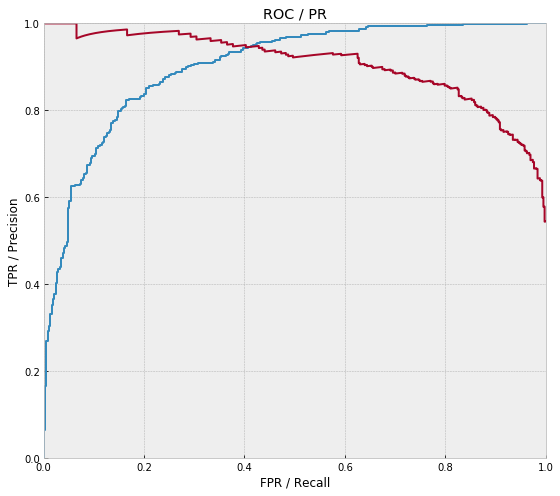

In [51]:
classification_metrics(y_test, pred, y_proba_1, target_names=[0, 1])   

In [52]:
features_test.columns[52:]

Index([], dtype='object', name='feature')

In [53]:

FEATURES_COLS = [
   'signal_x_Accel_mean', 'signal_x_Accel_std', 'signal_x_Accel_min',
       'signal_x_Accel_max', 'signal_x_Accel_median', 'signal_x_Accel_skew',
       'signal_x_Accel_kurtosis', 'signal_x_Accel_acf_mean',
       'signal_x_Accel_acf_std', 'signal_x_Accel_acv_mean',
       'signal_x_Accel_acv_std', 'signal_x_Accel_jitter',
       'signal_x_Accel_mean_crossing_rate', 'signal_y_Accel_mean',
       'signal_y_Accel_std', 'signal_y_Accel_min', 'signal_y_Accel_max',
       'signal_y_Accel_median', 'signal_y_Accel_skew',
       'signal_y_Accel_kurtosis', 'signal_y_Accel_acf_mean',
       'signal_y_Accel_acf_std', 'signal_y_Accel_acv_mean',
       'signal_y_Accel_acv_std', 'signal_y_Accel_jitter',
       'signal_y_Accel_mean_crossing_rate', 'signal_z_Accel_mean',
       'signal_z_Accel_std', 'signal_z_Accel_min', 'signal_z_Accel_max',
       'signal_z_Accel_median', 'signal_z_Accel_skew',
       'signal_z_Accel_kurtosis', 'signal_z_Accel_acf_mean',
       'signal_z_Accel_acf_std', 'signal_z_Accel_acv_mean',
       'signal_z_Accel_acv_std', 'signal_z_Accel_jitter',
       'signal_z_Accel_mean_crossing_rate', 'magnitude_Accel_mean',
       'magnitude_Accel_std', 'magnitude_Accel_min', 'magnitude_Accel_max',
       'magnitude_Accel_median', 'magnitude_Accel_skew',
       'magnitude_Accel_kurtosis', 'magnitude_Accel_acf_mean',
       'magnitude_Accel_acf_std', 'magnitude_Accel_acv_mean',
       'magnitude_Accel_acv_std', 'magnitude_Accel_jitter',
       'magnitude_Accel_mean_crossing_rate',
        'signal_x_Gyro_mean', 'signal_x_Gyro_std', 'signal_x_Gyro_min',
       'signal_x_Gyro_max', 'signal_x_Gyro_median', 'signal_x_Gyro_skew',
       'signal_x_Gyro_kurtosis', 'signal_x_Gyro_acf_mean',
       'signal_x_Gyro_acf_std', 'signal_x_Gyro_acv_mean',
       'signal_x_Gyro_acv_std', 'signal_x_Gyro_jitter',
       'signal_x_Gyro_mean_crossing_rate', 'signal_y_Gyro_mean',
       'signal_y_Gyro_std', 'signal_y_Gyro_min', 'signal_y_Gyro_max',
       'signal_y_Gyro_median', 'signal_y_Gyro_skew', 'signal_y_Gyro_kurtosis',
       'signal_y_Gyro_acf_mean', 'signal_y_Gyro_acf_std',
       'signal_y_Gyro_acv_mean', 'signal_y_Gyro_acv_std',
       'signal_y_Gyro_jitter', 'signal_y_Gyro_mean_crossing_rate',
       'signal_z_Gyro_mean', 'signal_z_Gyro_std', 'signal_z_Gyro_min',
       'signal_z_Gyro_max', 'signal_z_Gyro_median', 'signal_z_Gyro_skew',
       'signal_z_Gyro_kurtosis', 'signal_z_Gyro_acf_mean',
       'signal_z_Gyro_acf_std', 'signal_z_Gyro_acv_mean',
       'signal_z_Gyro_acv_std', 'signal_z_Gyro_jitter',
       'signal_z_Gyro_mean_crossing_rate', 'magnitude_Gyro_mean',
       'magnitude_Gyro_std', 'magnitude_Gyro_min', 'magnitude_Gyro_max',
       'magnitude_Gyro_median', 'magnitude_Gyro_skew',
       'magnitude_Gyro_kurtosis', 'magnitude_Gyro_acf_mean',
       'magnitude_Gyro_acf_std', 'magnitude_Gyro_acv_mean',
       'magnitude_Gyro_acv_std', 'magnitude_Gyro_jitter',
       'magnitude_Gyro_mean_crossing_rate'
]

In [55]:
# feature_importances = pd.Series(c.feature_importances_, index=FEATURES_COLS).sort_values(ascending=False)
# feature_importance_df = pd.DataFrame(feature_importances)
# feature_importance_df.reset_index(inplace=True)
# feature_importance_df.columns = ['feature', 'importance']
# feature_importance_df.set_index('feature').plot(kind='barh', figsize=(26, 26), fontsize=14)

# check specific sample for prediction with video of dangerous ride with bus

In [56]:
def generate_features_from_df(sample, filename):
    sample=sample.reset_index()
    sample["timestamp"] = pd.to_datetime(sample['timestamp'], unit="s")
    
    
    
    sample = sample.resample('1S', on="timestamp").mean()
#     print(sample.shape)
#     print(sample.head())
    
    # Acceleration
    sample["magnitude"] = np.sqrt(np.square(sample).sum(axis=1))
    
    # Statistical aggregates
    
    # Note the trickery to get right format from pandas
    # without manual renaming
    aggs = (sample
            .apply(["mean", "std", "min", "max","median","skew","kurtosis",acf_mean,acf_std,acv_mean,acv_std,jitter,mean_crossing_rate])
            .unstack()
            .reset_index())
    aggs["feature"] = aggs["level_0"].str.cat(aggs["level_1"], sep="_{}_".format(filename))

    return aggs.set_index("feature")[0]

In [57]:
#this is the ide sample of the cool video: b85f3d48e1204b9d2794d3c32be81550
selceted_file_bus_car=pd.read_csv('nexar/f1/b85f3d48e1204b9d2794d3c32be81550_Accel.csv')
print(selceted_file_bus_car.shape)
selceted_file_bus_car.head()

(2051, 4)


,timestamp,signal_x,signal_y,signal_z
0,1.515687e+09,0.992,0.060,-0.032
1,1.515687e+09,1.016,0.072,-0.040
2,1.515687e+09,0.982,0.059,-0.023
3,1.515687e+09,1.028,0.066,-0.049
4,1.515687e+09,0.967,0.047,-0.023


In [58]:
# accel_for_features=selceted_file_bus_car
accel=selceted_file_bus_car
# Calculating absolute acceleration
# accel["acceleration"] = np.sqrt(np.square(accel).sum(axis=1))
accel["timestamp"] = pd.to_datetime(accel['timestamp'],unit='s')
accel.set_index('timestamp',inplace=True)


In [59]:
accel_10s_beginning=accel.loc['2018-01-11 16:02:17':'2018-01-11 16:02:27',:] # first 10 seconds of the ride
print(accel_10s_beginning.shape)
accel_extend_synt=pd.concat([accel_10s_beginning,accel_10s_beginning,accel_10s_beginning,accel_10s_beginning,accel])
print(accel_extend_synt.shape)
accel_extend_synt.tail()

(564, 3)
(4307, 3)


,signal_x,signal_y,signal_z
timestamp,,,
2018-01-11 16:02:56.918999910,0.943,0.107,-0.025
2018-01-11 16:02:56.937999964,1.009,0.054,-0.009
2018-01-11 16:02:56.957999945,0.936,0.056,0.051
2018-01-11 16:02:56.977999926,0.883,0.030,0.034
2018-01-11 16:02:56.997000217,0.998,0.034,-0.096


## Visualize the original accel. file and the extended accel. file

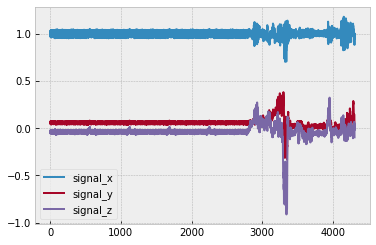

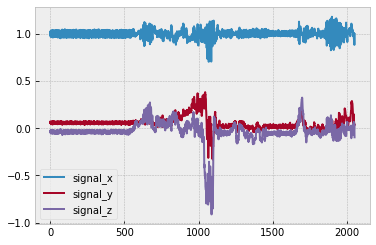

In [60]:
accel_extend_synt.reset_index()[['signal_x','signal_y','signal_z']].plot()
accel.reset_index()[['signal_x','signal_y','signal_z']].plot()

In [61]:
accel['date']=accel.index

## slide over the syntetic file and get 40 seconds files to run on a model

In [62]:
j=0
samples=[]
for i in np.arange(40):# we need to get 40 samples each file ith size 2000 lines
    
    df=accel_extend_synt.iloc[j:j+2000,:]
    samples.append(df)
    j=j+50

40


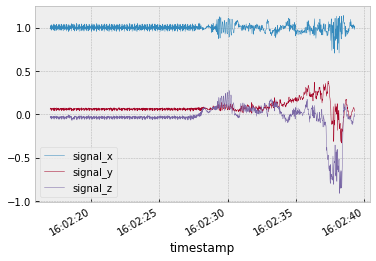

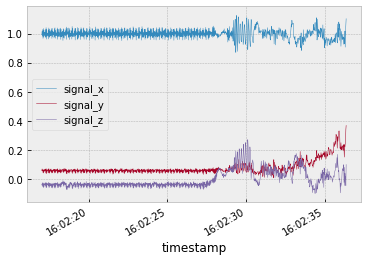

In [63]:
print(len(samples))
sample_1=samples[28]
sample_2=samples[25]

sample_1.plot(linewidth=0.5)
sample_2.plot(linewidth=0.5)


In [64]:
features=[]
for sample in samples:
    f=generate_features_from_df(sample,'accel_')
    features.append(pd.DataFrame(f).transpose()) # add all features to a list

In [65]:
features_ready=pd.concat(features, ignore_index=True) # make the llist  of features into a data frame

In [66]:
print(features_ready.shape)
features_ready[20:30]

(40, 52)


feature,signal_x_accel__mean,signal_x_accel__std,signal_x_accel__min,signal_x_accel__max,signal_x_accel__median,signal_x_accel__skew,signal_x_accel__kurtosis,signal_x_accel__acf_mean,signal_x_accel__acf_std,signal_x_accel__acv_mean,...,magnitude_accel__max,magnitude_accel__median,magnitude_accel__skew,magnitude_accel__kurtosis,magnitude_accel__acf_mean,magnitude_accel__acf_std,magnitude_accel__acv_mean,magnitude_accel__acv_std,magnitude_accel__jitter,magnitude_accel__mean_crossing_rate
20,1.002112,0.005582,0.997902,1.021745,1.000902,3.514370,13.109008,0.033333,0.262665,9.693271e-07,...,1.025376,1.003394,3.137865,10.682055,0.033333,0.277467,1.087450e-06,0.000009,0.003535,0.071429
21,1.002061,0.005425,0.997902,1.021745,1.000892,3.569449,13.615855,0.031250,0.255596,8.623422e-07,...,1.025376,1.003533,3.325341,11.952685,0.031250,0.259956,9.464461e-07,0.000008,0.003624,0.200000
22,0.999622,0.010878,0.962625,1.021745,1.000882,-2.187537,10.087033,0.029412,0.260304,3.275670e-06,...,1.025376,1.003394,-1.024469,7.704273,0.029412,0.266172,2.251221e-06,0.000020,0.005064,0.625000
23,1.000915,0.011242,0.964904,1.021745,1.000892,-1.388801,7.026528,0.027778,0.269231,3.315415e-06,...,1.028176,1.003449,-0.211530,4.628294,0.027778,0.261422,2.921576e-06,0.000027,0.007727,0.411765
24,0.997874,0.015638,0.949429,1.021745,1.000882,-2.129784,5.621895,0.026316,0.264737,6.096954e-06,...,1.025376,1.003394,-1.221222,3.553050,0.026316,0.267113,4.261545e-06,0.000043,0.010153,0.388889
25,0.997922,0.013126,0.964904,1.021745,1.000797,-1.334872,2.688043,0.025000,0.242368,4.092101e-06,...,1.025376,1.003463,-0.459314,4.262745,0.025000,0.262954,2.354918e-06,0.000025,0.009155,0.368421
26,0.996766,0.013934,0.964904,1.021745,1.000692,-1.132181,1.408638,0.023810,0.261457,4.402350e-06,...,1.038501,1.003504,0.508069,3.228813,0.023810,0.234951,3.424031e-06,0.000034,0.010127,0.250000
27,0.994963,0.015900,0.961941,1.021745,1.000731,-1.052460,0.465735,0.022727,0.256057,5.484518e-06,...,1.181747,1.003580,3.345240,12.104605,0.022727,0.233718,3.869826e-05,0.000398,0.016148,0.238095
28,0.996989,0.015223,0.961941,1.021745,1.000692,-1.011040,1.196011,0.021739,0.229921,4.819056e-06,...,1.089168,1.003656,2.607002,9.969331,0.021739,0.225093,8.904378e-06,0.000092,0.014309,0.227273
29,0.996456,0.014181,0.961941,1.021745,1.000596,-1.274178,1.742328,0.020833,0.235332,4.014963e-06,...,1.089168,1.003635,2.849048,11.413361,0.020833,0.218149,8.090959e-06,0.000085,0.014701,0.260870


In [69]:
# features_ready.isnull()

In [70]:
#use average for nan values
# features_ready=features_ready.fillna(features_ready.mean())

In [71]:
pred_bus_sample=c.predict(features_ready)
prob_bus_sample=c.predict_proba(features_ready)
prob_bus_sample=pd.DataFrame(prob_bus_sample).iloc[:,1].tolist()

In [72]:
print(prob_bus_sample[25],prob_bus_sample[28])
pred_bus_sample, prob_bus_sample  #I see in the list of prediction that items #28 #25 are predicted in a very weord way

# looking at avisalization of these 2 samples it looks ok. let's look at the features:



0.013965660063023218 0.978962876560595


(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 [0.00027878394267819614,
  0.00027878394267819614,
  0.000885199984753155,
  0.000621519842863083,
  0.0001714960193461511,
  0.0001714960193461511,
  0.00044574126452733253,
  0.0001714960193461511,
  0.0001714960193461511,
  0.0005446645119356127,
  0.00027878394267819614,
  0.004543651217075743,
  0.00027878394267819614,
  0.0001714960193461511,
  0.00027878394267819614,
  0.0001714960193461511,
  0.0001714960193461511,
  0.005439634133687315,
  0.035489923425720216,
  0.11850995047761041,
  0.15679868685462958,
  0.19311571914271294,
  0.3343405079420642,
  0.013009926776734928,
  0.19257877557989964,
  0.013965660063023218,
  0.38845482124630554,
  0.8970836559323061,
  0.978962876560595,
  0.9994285228293054,
  0.9976815595808545,
  0.9994914690894723,
  0.9985133790049276,
  0.9997642962906084,
  0.99988767620982,
  0.9996745322814353,
  0.99

In [73]:
features_ready.loc[25:28,:]

feature,signal_x_accel__mean,signal_x_accel__std,signal_x_accel__min,signal_x_accel__max,signal_x_accel__median,signal_x_accel__skew,signal_x_accel__kurtosis,signal_x_accel__acf_mean,signal_x_accel__acf_std,signal_x_accel__acv_mean,...,magnitude_accel__max,magnitude_accel__median,magnitude_accel__skew,magnitude_accel__kurtosis,magnitude_accel__acf_mean,magnitude_accel__acf_std,magnitude_accel__acv_mean,magnitude_accel__acv_std,magnitude_accel__jitter,magnitude_accel__mean_crossing_rate
25,0.997922,0.013126,0.964904,1.021745,1.000797,-1.334872,2.688043,0.025000,0.242368,0.000004,...,1.025376,1.003463,-0.459314,4.262745,0.025000,0.262954,0.000002,0.000025,0.009155,0.368421
26,0.996766,0.013934,0.964904,1.021745,1.000692,-1.132181,1.408638,0.023810,0.261457,0.000004,...,1.038501,1.003504,0.508069,3.228813,0.023810,0.234951,0.000003,0.000034,0.010127,0.250000
27,0.994963,0.015900,0.961941,1.021745,1.000731,-1.052460,0.465735,0.022727,0.256057,0.000005,...,1.181747,1.003580,3.345240,12.104605,0.022727,0.233718,0.000039,0.000398,0.016148,0.238095
28,0.996989,0.015223,0.961941,1.021745,1.000692,-1.011040,1.196011,0.021739,0.229921,0.000005,...,1.089168,1.003656,2.607002,9.969331,0.021739,0.225093,0.000009,0.000092,0.014309,0.227273


/opt/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


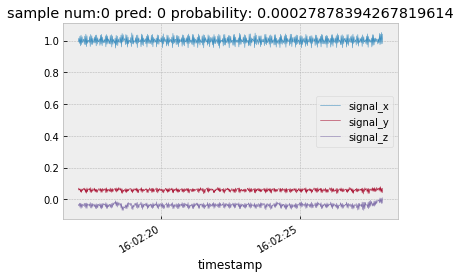

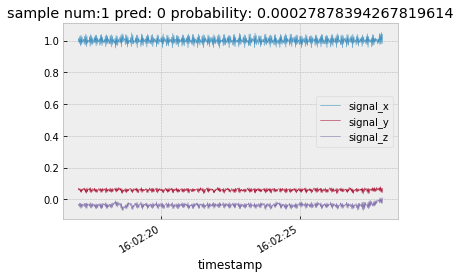

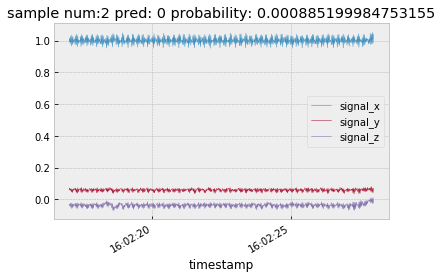

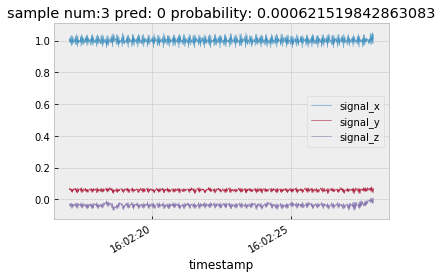

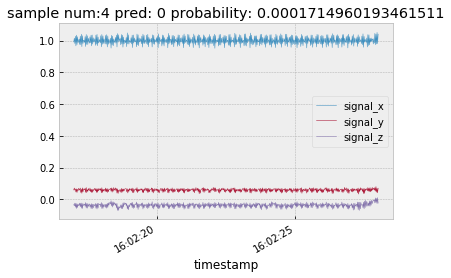

...

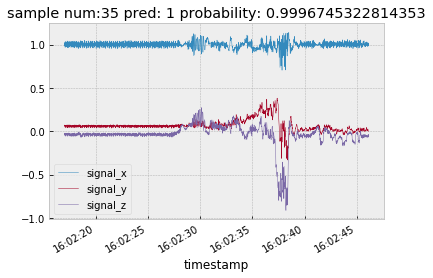

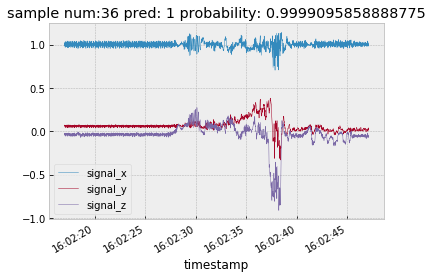

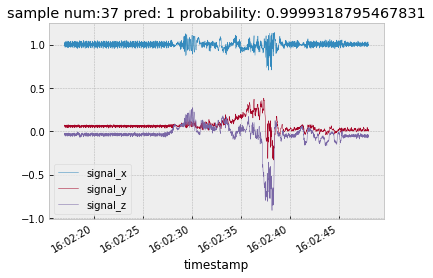

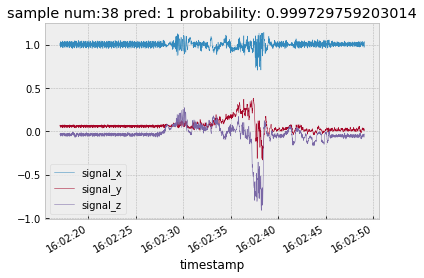

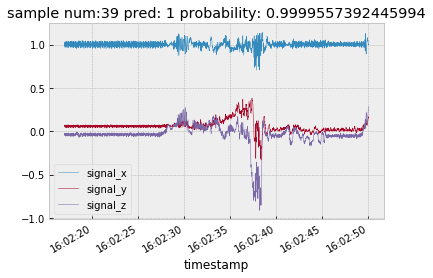

In [74]:
for i,sample in enumerate(samples):
    sample.plot(linewidth=0.5, title="sample num:{} pred: {} probability: {}".format(i,pred_bus_sample[i], prob_bus_sample[i],5)) 


## Probabilities

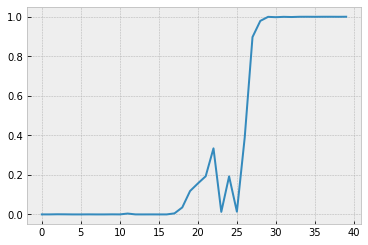

In [75]:
fig1 = plt.figure(1)
#distribution of probablilty:
pd.Series(prob_bus_sample).plot()
# prob_bus_sample.plot()

# Animation

In [76]:
!pip3 install plotly_express
!pip3 install plotly 

In [78]:
import sys
sys.path.insert(0,'/usr/local/lib/python3.5/site-packages/') #I dont lnow why is this happening but libraries are installed not in anaconda env. so I need to add it manually
sys.path.insert(0,'/usr/local/lib/python3.5/dist-packages/')
sys.path.insert(0,'/usr/local/bin')


In [89]:
# import sys
# !npm install -g electron@1.8.4 orca --unsafe-perm=true
# !pip3 install psutil
# # !mv /usr/local/bin/orca /usr/local/bin/usr/local/sbin/usr/local/bin/usr/sbin/usr/bin /sbin/bin
# # !mv /usr/local/bin/electron /usr/local/bin/usr/local/sbin/usr/local/bin/usr/sbin /usr/bin/sbin/bin
# !ls /usr/local/bin/
# sys.path
# # !ls /usr/local/lib/python3.5/dist-packages/

## plot the smaple in plotly for interactivity

In [70]:
accel=accel_df
accel["date"]=accel.index
accel.head()

,signal_x,signal_y,signal_z,date
timestamp,,,,
2018-08-19 21:19:03.012259960,0.311,-0.994,0.093,2018-08-19 21:19:03.012259960
2018-08-19 21:19:03.031577826,0.332,-1.047,0.130,2018-08-19 21:19:03.031577826
2018-08-19 21:19:03.050896168,0.348,-1.063,0.159,2018-08-19 21:19:03.050896168
2018-08-19 21:19:03.070213079,0.312,-1.016,0.154,2018-08-19 21:19:03.070213079
2018-08-19 21:19:03.089530945,0.235,-0.974,0.106,2018-08-19 21:19:03.089530945


In [79]:
import plotly
from plotly.offline import init_notebook_mode, plot_mpl
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['animation.ffmpeg_path'] = '/usr/local/bin/ffmpeg'
from plotly.offline import init_notebook_mode, iplot
from plotly.offline import download_plotlyjs, init_notebook_mode, plot,iplot
from IPython.display import display, HTML
import sys
import imp
import plotly_express as px
import plotly.plotly as py
import plotly.graph_objs as go
import matplotlib.animation as animation
trace_x = go.Scatter(
    x = accel['date'],
    y = accel['signal_x'],
    mode = 'lines',
    name = 'x'
)
trace_y = go.Scatter(
    x = accel['date'],
    y = accel['signal_y'],
    mode = 'lines',
    name = 'y'
)
trace_z = go.Scatter(
    x = accel['date'],
    y = accel['signal_z'],
    mode = 'lines',
    name = 'z'
)
layout=go.Layout(title="Is This Ride Dangerous?", font=dict(
                size=24,
                color='#1C37C7'
            ))
data = [trace_x, trace_y, trace_z]
fig = go.Figure(data=data, layout=layout)
py.plot(fig)

PlotlyRequestError: Account limit reached: Your account is limited to creating 25 charts. To continue, you can override or delete existing charts or you can upgrade your account at: https://plot.ly/products/cloud

In [80]:
%matplotlib notebook 


In [81]:
accel['date']=accel.index

In [82]:
# import os
# if not os.path.exists('images'):
#     os.mkdir('images')

In [85]:
init_notebook_mode(connected=True)
# import plotly.io as pio



x0=accel['date'].min()
x1=accel['date'].min()
y0=accel['signal_z'].min()
y1=1.15
shapes = list()
for j in range(40):
    shapes.append({'type': 'line',
                   'xref': 'x',
                   'yref': 'y',
                   'x0': x0 + pd.to_timedelta(j, unit='s'),
                   'y0': y0,
                   'x1': x1 + pd.to_timedelta(j, unit='s'),
                   'y1': y1})
trace_x = go.Scatter(
    x = accel['date'],
    y = accel['signal_x'],
    mode = 'lines',
    name = 'x'
)
trace_y = go.Scatter(
    x = accel['date'],
    y = accel['signal_y'],
    mode = 'lines',
    name = 'y'
)
trace_z = go.Scatter(
    x = accel['date'],
    y = accel['signal_z'],
    mode = 'lines',
    name = 'z'
)
data = [trace_x, trace_y, trace_z]
ims = []
for i in range(40):
    layout = go.Layout(shapes=shapes[i:i+1] , title=" Second:{} Prediction:{} : Probability {}".format(i+1,pred_bus_sample[i], round(prob_bus_sample[i],3)))
    fig = go.Figure(data=data,layout=layout)
#     im = plt.imshow(fig, animated=True)
#     pio.write_image(fig, 'images/fig1.png')
    iplot(fig)
    

In [324]:
shapes[1]

{'type': 'line',
 'xref': 'x',
 'yref': 'y',
 'x0': Timestamp('2018-01-11 16:02:18.002000093'),
 'y0': -0.9129999999999999,
 'x1': Timestamp('2018-01-11 16:02:18.002000093'),
 'y1': 1.15}